# Descubrimientos de patrones de accidentes de tránsito en la CDMX

## Creación de imagenes para texto

In [1]:
from math import radians, cos, sin, asin, sqrt, atan2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
from pylab import rcParams
import seaborn as sns
import folium
import networkx as nx
import osmnx as ox
import geopandas as gpd
import contextily as ctx
from shapely.geometry import Point, Polygon, LineString, MultiLineString
import shapefile as shp
import gpd_lite_toolbox as glt
from gpd_lite_toolbox.utils_carto import m_plot_dataframe, m_plot_multipolygon
import warnings
warnings.filterwarnings('ignore')
pd.set_option('display.max_columns', None)

In [2]:
alcaldias = gpd.read_file('/Users/daniel.rodriguez/Documents/ACC/ACC_PROOF/ACC1//shp_b//original_data//alcaldias_cdmx//alcaldias.shp')
alcaldias.replace([
                   'CuauhtÃ©moc', 
                   'Ã\x81lvaro ObregÃ³n', 
                   'Xochimilco', 
                   'TlÃ¡huac',
                   'Benito JuÃ¡rez', 
                   'Cuajimalpa de Morelos', 
                   'Gustavo A. Madero',
                   'Tlalpan', 
                   'Venustiano Carranza', 
                   'Azcapotzalco', 
                   'Iztapalapa',
                   'Iztacalco', 
                   'Miguel Hidalgo', 
                   'La Magdalena Contreras',
                   'CoyoacÃ¡n', 
                   'Milpa Alta'],
                  [
                   'Cuauhtemoc',
                   'Alvaro Obregon',
                   'Xochimilco',
                   'Tlahuac',
                   'Benito Juarez',
                   'Cuajimalpa de Morelos',
                   'Gustavo A. Madero',
                   'Tlalpan',
                   'Venustiano Carranza',
                   'Azcapotzalco',
                   'Iztapalapa',
                   'Iztacalco',
                   'Miguel Hidalgo',
                   'La Magdalena Contreras',
                   'Coyoacan',
                   'Milpa Alta'], inplace = True)
alcaldias = alcaldias[['nomgeo','geometry']]

In [3]:
hex100 = gpd.read_file('/Users/daniel.rodriguez/Documents/ACC/ACC_PROOF/ACC1//shp_b//processed_data//hex_roads//road_hex100.shp')

In [4]:
hex_alc = gpd.sjoin(hex100, alcaldias, op = 'intersects')
hex_cuauh = hex_alc[hex_alc['nomgeo']=='Cuauhtemoc']
hex_cuauh1 = hex_cuauh.to_crs(epsg = 3857)
hex_alc1 = hex_alc.to_crs(epsg=3857)

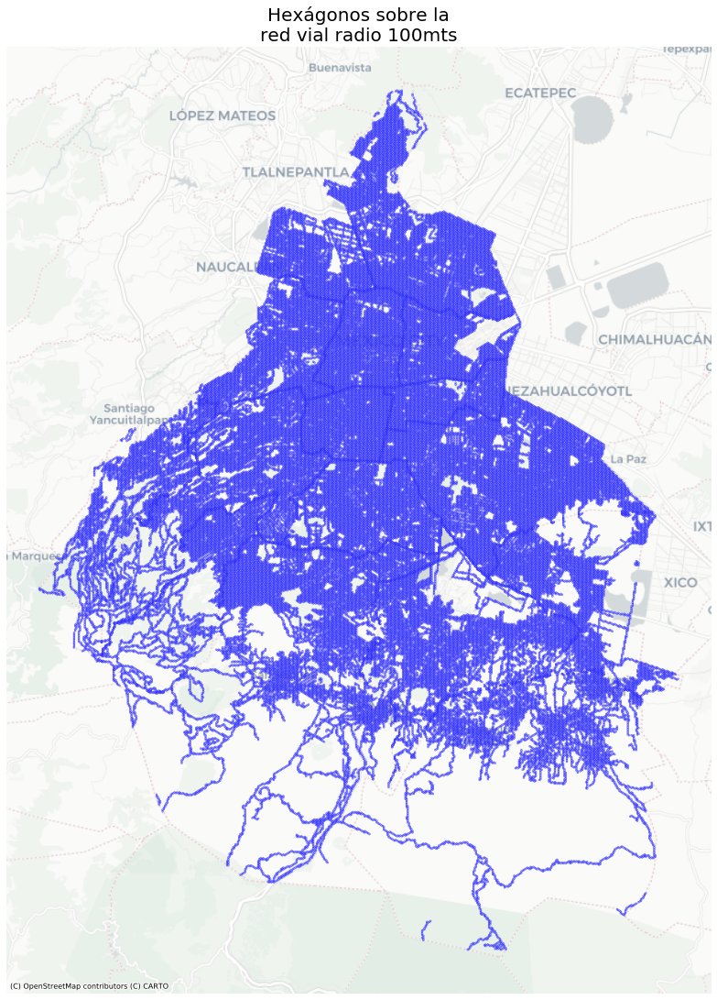

In [186]:
fig, ax = plt.subplots(figsize = (15,19))
#alcaldias.plot(ax = ax, color = 'lightblue', alpha = 0.3, edgecolor = 'black')
hex_alc1.plot(ax = ax,alpha = 0.5, color = 'white', linewidth=0.9, edgecolor = 'blue')
ctx.add_basemap(ax,url=ctx.providers.CartoDB.Positron)
plt.axis('off')
plt.title("Hexágonos sobre la\nred vial radio 100mts", loc='Center', fontsize=20, fontweight=0, color='black')
fig.savefig('/Users/daniel.rodriguez/Documents/ACC/ACC_PROOF/ACC1/puntos_cuadro5/base_mapas/HEXA100.png', format = 'png', dpi = 200,bbox_inches = "tight")

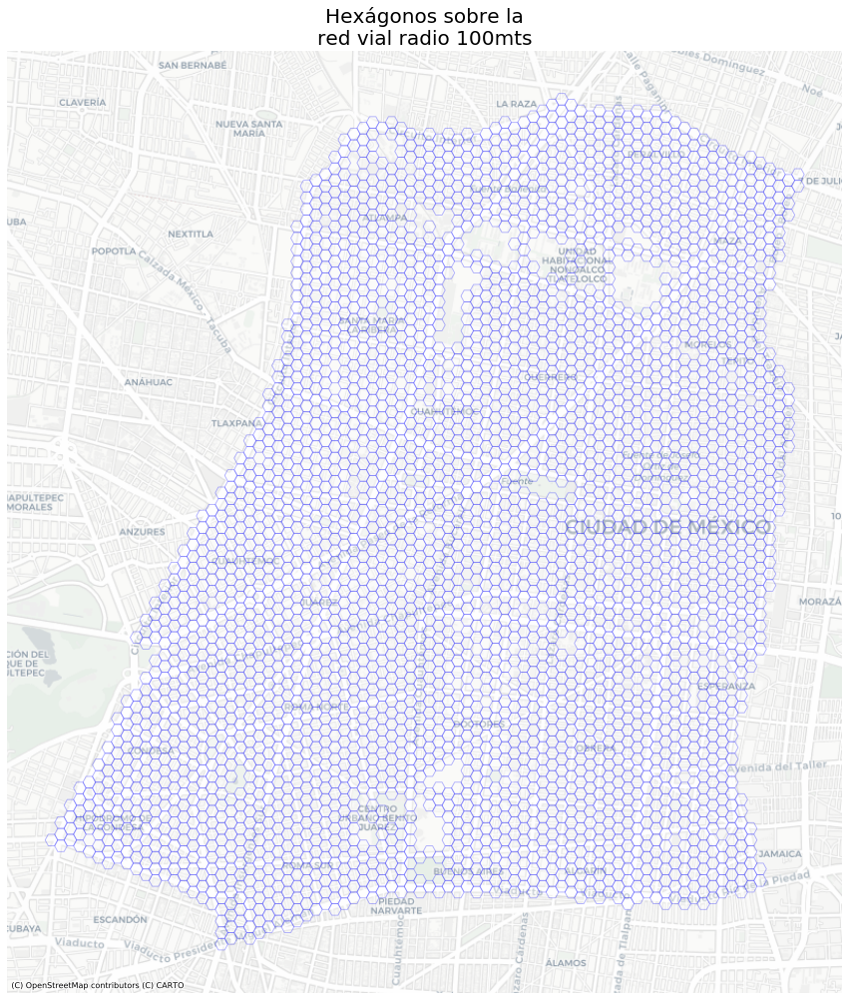

In [187]:
fig, ax = plt.subplots(figsize = (15,19))
#alcaldias.plot(ax = ax, color = 'lightblue', alpha = 0.3, edgecolor = 'black')
hex_cuauh1.plot(ax = ax, alpha = 0.3, color = 'white',linewidth=0.9, edgecolor = 'blue')
ctx.add_basemap(ax,url=ctx.providers.CartoDB.Positron)
plt.axis('off')
plt.title("Hexágonos sobre la\nred vial radio 100mts", loc='Center', fontsize=20, fontweight=0, color='black')
fig.savefig('/Users/daniel.rodriguez/Documents/ACC/ACC_PROOF/ACC1/puntos_cuadro5/base_mapas/HEXA100_zoom.png', format = 'png', dpi = 200,bbox_inches = "tight")

In [5]:
real_pts= gpd.read_file('/Users//daniel.rodriguez/Documents/ACC/ACC_PROOF//ACC1//shp_b//processed_data//ptosC5//pts_real.shp')

In [6]:
pts_clean = real_pts[real_pts.geometry.type =='Point']

In [7]:
pts_alc = gpd.sjoin(pts_clean, alcaldias, op = 'intersects')

In [9]:
real_pts19 = pts_alc[pts_alc['ano']=='2019']

In [115]:
di = {'accidente-choque sin lesionados'              :'choque_sin_lesion',
      'sismo-choque sin lesionados'                  :'choque_sin_lesion',
      
      'accidente-choque con lesionados'              :'choque_con_lesion',
      'lesionado-accidente automovilístico'          :'choque_con_lesion',
      'sismo-choque con lesionados'                  :'choque_con_lesion', 
      'detención ciudadana-accidente automovilístico':'choque_con_lesion',
      
      'lesionado-atropellado'                        :'choque_atropellado_grave',
      'detención ciudadana-atropellado'              :'choque_atropellado_grave',
      'sismo-persona atropellada'                    :'choque_atropellado_grave',
      
      'accidente-volcadura'                          :'acc_volcadura_grave', 
       
      'accidente-persona atrapada / desbarrancada'   :'acc_persona_atrapada_grave', 
      
      'accidente-otros'                              :'choque_otros_con_lesion',
      
      'cadáver-atropellado'                          :'atropellado_fatal', 
      
      'cadáver-accidente automovilístico'            :'accidente_fatal',
       
      'accidente-ferroviario'                        :'choque_ferroviario_grave', 
      
      'accidente-motociclista'                       :'choque_motociclista_con_lesion',
      
      'accidente-choque con prensados'               :'choque_prensado_grave', 
      'sismo-choque con prensados'                   :'choque_prensado_grave',
      
      'accidente-vehiculo atrapado'                  :'acc_vehiculo_atrapado_grave',
      'accidente-vehículo atrapado-varado'           :'acc_vehiculo_atrapado_grave',
      
      'accidente-vehiculo desbarrancado'             :'acc_vehiculo_desbarrancado_grave', 
       
      'accidente-ciclista'                           :'choque_ciclista_con_lesion',
      
      'accidente-monopatín'                          :'choque_monopatin_con_lesion'}

real_pts19.incidente_.replace(di, inplace = True)

In [237]:

acc_cuau = real_pts19[real_pts19['nomgeo']=='Cuauhtemoc']
acc_cuau1 = acc_cuau.to_crs(epsg = 3857)
real_pts19_ = real_pts19.to_crs(epsg = 3857)
pts_clean_ = pts_clean.to_crs(epsg = 3857)

In [117]:
lista_tipo = ['choque_sin_lesion', 
               'choque_con_lesion', 
               'acc_volcadura_grave',
               'choque_atropellado_grave', 
               #'choque_ciclista_con_lesion',
               'acc_persona_atrapada_grave', 
               'choque_motociclista_con_lesion',
               'acc_vehiculo_atrapado_grave', 
               'atropellado_fatal',
               'choque_prensado_grave', 
               'accidente_fatal',
               'choque_otros_con_lesion']
               #'choque_monopatin_con_lesion']

acc_cuau2 = acc_cuau1[acc_cuau1['incidente_'].isin(lista_tipo)]

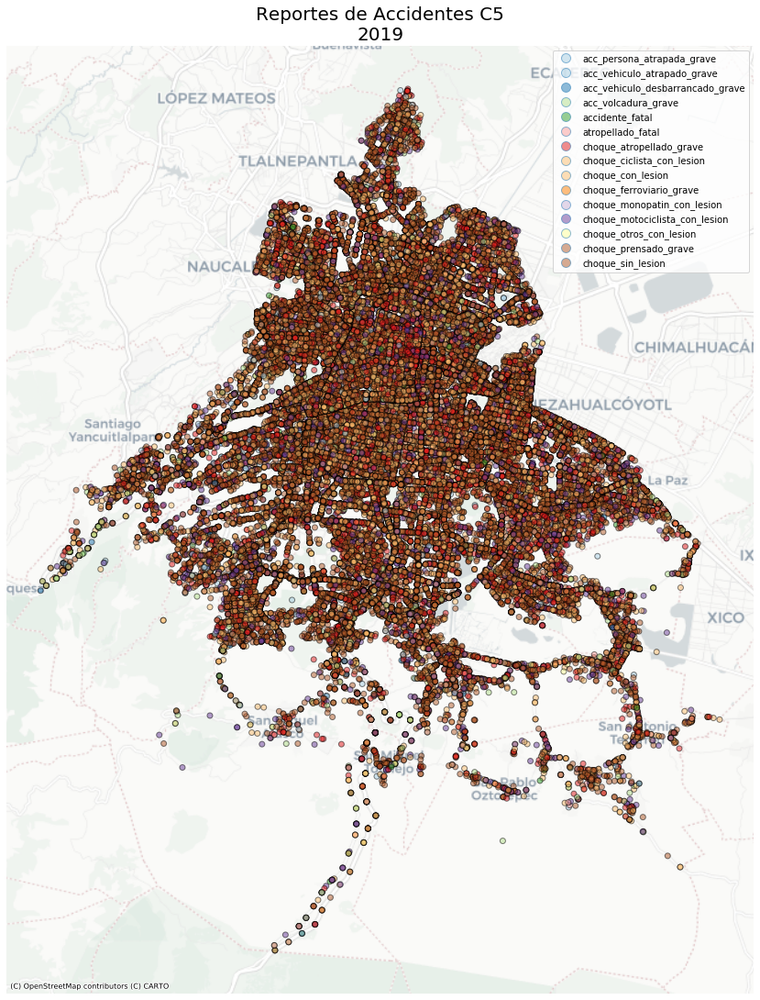

In [188]:
fig, ax = plt.subplots(figsize = (15,19))
#alcaldias.plot(ax = ax, color = 'lightblue', alpha = 0.3, edgecolor = 'black')
real_pts19_.plot(column = 'incidente_', categorical = True, cmap = 'Paired', 
               legend = True, legend_kwds = {'loc':'upper right'},
               marker = "o",
               ax = ax, alpha = 0.5, edgecolor = 'black')
ctx.add_basemap(ax,url=ctx.providers.CartoDB.Positron)
plt.axis('off')
#ax.set(xlim=(-11034000,-11042500), ylim=(2201500, 2210000)) 
plt.title("Reportes de Accidentes C5\n2019", loc='Center', fontsize=20, fontweight=0, color='black')
fig.savefig('/Users/daniel.rodriguez/Documents/ACC/ACC_PROOF/ACC1/puntos_cuadro5/base_mapas/PTOSc5.png', format = 'png', dpi = 200,bbox_inches = "tight")

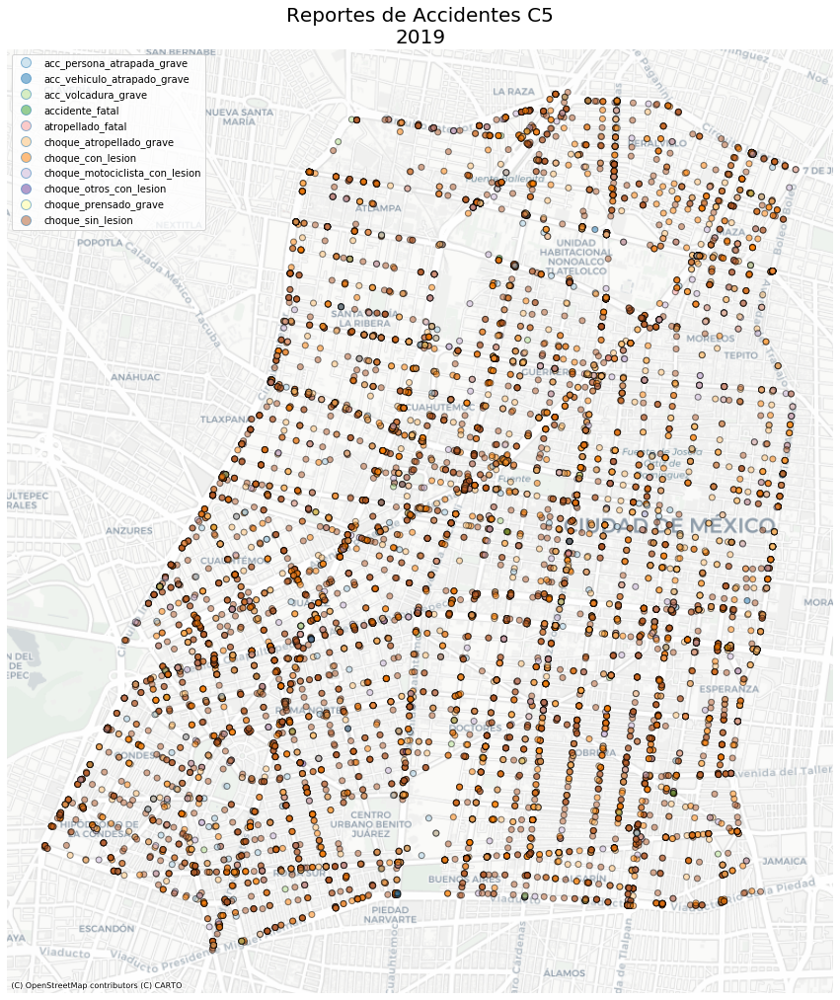

In [189]:
fig, ax = plt.subplots(figsize = (15,19))
#alcaldias.plot(ax = ax, color = 'lightblue', alpha = 0.3, edgecolor = 'black')
acc_cuau2.plot(column = 'incidente_', categorical = True, cmap = 'Paired', 
               legend = True, legend_kwds = {'loc':'upper left'},
               marker = "o",
               ax = ax, alpha = 0.5, edgecolor = 'black')
ctx.add_basemap(ax,url=ctx.providers.CartoDB.Positron)
plt.axis('off')
#ax.set(xlim=(-11034000,-11042500), ylim=(2201500, 2210000)) 
plt.title("Reportes de Accidentes C5\n2019", loc='Center', fontsize=20, fontweight=0, color='black')
fig.savefig('/Users/daniel.rodriguez/Documents/ACC/ACC_PROOF/ACC1/puntos_cuadro5/base_mapas/PTOSc5_zoom.png', format = 'png', dpi = 200,bbox_inches = "tight")

In [131]:
pois_alc = gpd.read_file('/Users/daniel.rodriguez/Documents/ACC/ACC_PROOF/ACC1//shp_b//processed_data//shp_OSM//pois.shp')

pois_usados = ['university',
            'school',
            'kindergarten',
            'college',
            'theatre',
            'nightclub',
            'cinema',
            'park',
            'restaurant',
            'pub',
            'bar',
            'supermarket',
            'mall',
            'bank',
            'museum',
            'attraction',
            'hospital',
            'hotel']

pois1 = pois_alc[pois_alc['fclass'].isin(pois_usados)]

cuau_p = pois1[pois1['nomgeo']=='Cuauhtemoc']
cuau_p1 = cuau_p.to_crs(epsg = 3857)
pois2 = pois1.to_crs(epsg = 3857)

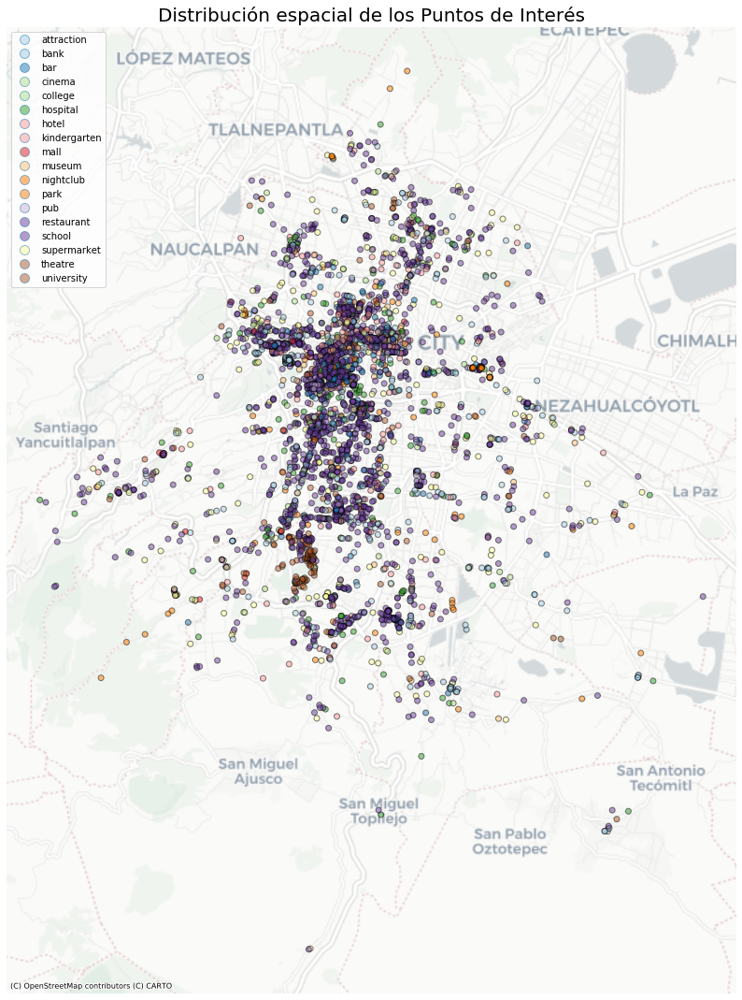

In [190]:
fig, ax = plt.subplots(figsize = (15,19))
#alcaldias.plot(ax = ax, color = 'lightblue', alpha = 0.3, edgecolor = 'black')
pois2.plot(column = 'fclass', categorical = True, cmap = 'Paired',
          legend = True, legend_kwds = {'loc':'upper left'},
          marker = "o", ax = ax, alpha = 0.5, edgecolor = 'black')
ctx.add_basemap(ax,url=ctx.providers.CartoDB.Positron)
plt.axis('off')
plt.title("Distribución espacial de los Puntos de Interés", loc='Center', fontsize=20, fontweight=0, color='black')
fig.savefig('/Users/daniel.rodriguez/Documents/ACC/ACC_PROOF/ACC1/puntos_cuadro5/base_mapas/POIS.png', format = 'png', dpi = 200,bbox_inches = "tight")

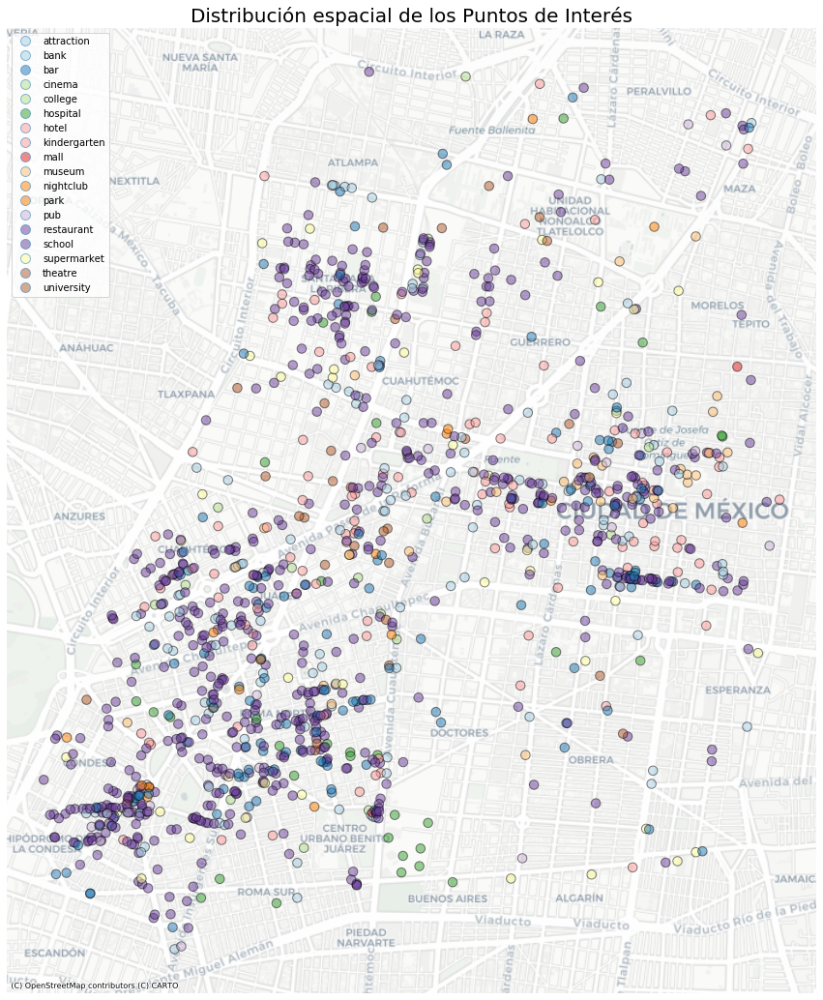

In [191]:
fig, ax = plt.subplots(figsize = (15,19))
#alcaldias.plot(ax = ax, color = 'lightblue', alpha = 0.3, edgecolor = 'black')
cuau_p1.plot(column = 'fclass', categorical = True, cmap = 'Paired',
          legend = True, legend_kwds = {'loc':'upper left'},
          marker = "o", ax = ax, alpha = 0.5, edgecolor = 'black',markersize=90)
ctx.add_basemap(ax,url=ctx.providers.CartoDB.Positron)
plt.axis('off')
plt.title("Distribución espacial de los Puntos de Interés", loc='Center', fontsize=20, fontweight=0, color='black')
fig.savefig('/Users/daniel.rodriguez/Documents/ACC/ACC_PROOF/ACC1/puntos_cuadro5/base_mapas/POIS_zoom.png', format = 'png', dpi = 200,bbox_inches = "tight")

In [137]:
roads_alc = gpd.read_file('/Users/daniel.rodriguez/Documents/ACC/ACC_PROOF/ACC1//shp_b//processed_data//shp_OSM//roads.shp')

In [143]:
dictionary={'residential':'Caminos Residenciales',       
    'tertiary':'Vías terciarias',          
    'secondary':'Vías secundarias',         
    'primary':'Vías primarias',           
    'pedestrian':'Calles peatonales',        
    'secondary_link':'Vías secundarias conectoras',    
    'steps':'Escaleras',             
    'path':'camino no especificado',              
    'trunk':'Carreteras conectoras',             
    'track':'Camino de grava',             
    'unclassified':'No clasificado',      
    'primary_link':'Vía primaria conectora',      
    'living_street':'Prioridad peatonal',     
    'motorway_link':'Autopista conectora',     
    'motorway':'Autopista',          
    'trunk_link':'Carretera conectora',        
    'tertiary_link':'Vía terciaria conectora',     
    'cycleway':'Ciclovia',          
    'unknown':'Desconocida',           
    'track_grade2':'semi_pavimentada',      
    'bridleway':'Caminos montar caballos'}

roads_alc.fclass.replace(dictionary, inplace = True)

In [144]:

cuauhtemoc = roads_alc[roads_alc['nomgeo']=='Cuauhtemoc']
cuauhtemoc1 = cuauhtemoc.to_crs(epsg = 3857)
roads_alc1 = roads_alc.to_crs(epsg = 3857)

In [145]:
roads_alc1.head()

,fclass,name,nomgeo,geometry
0,Vía primaria conectora,Tintoreto,Benito Juarez,LINESTRING (-11041220.5551212 2200336.78528744...
1,Vías primarias,Gabriel Ramos MillÃ¡n,Benito Juarez,LINESTRING (-11036223.66808237 2200061.3527987...
2,Caminos Residenciales,Calle San Borja,Benito Juarez,LINESTRING (-11037634.9654547 2199940.76087064...
3,Caminos Residenciales,Calle Mitla,Benito Juarez,LINESTRING (-11037331.04098093 2200945.2997486...
4,Caminos Residenciales,Calle SerafÃ­n Olarte,Benito Juarez,LINESTRING (-11037650.41660002 2199844.4318410...


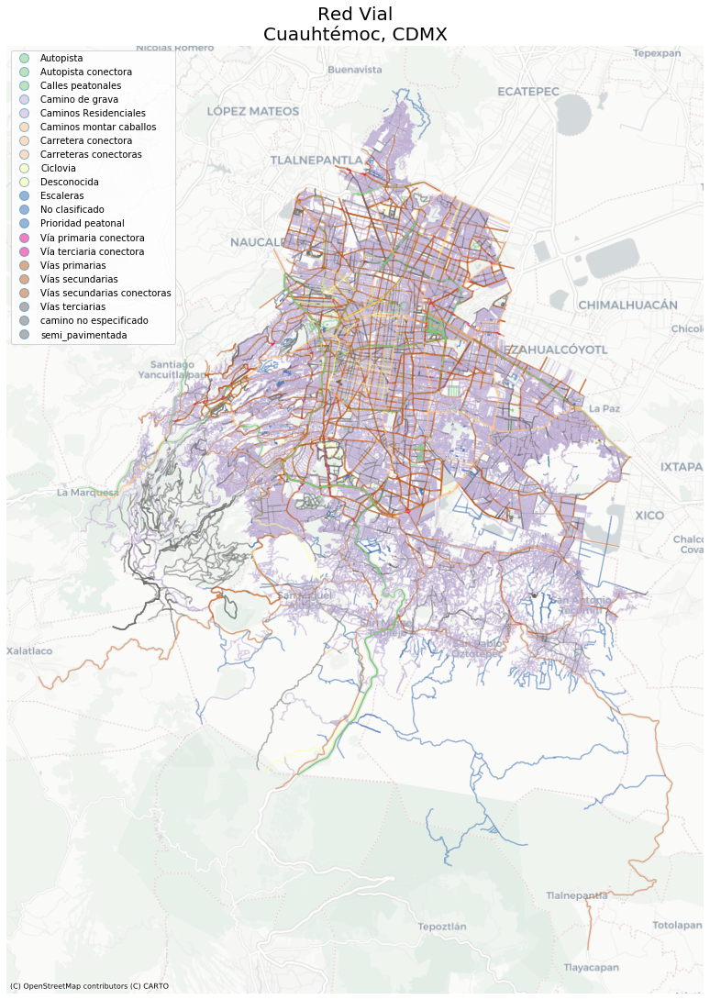

In [192]:
fig, ax = plt.subplots(figsize = (15,19))
#cuau_alc.plot(ax = ax, color = 'lightblue', alpha = 0.3, edgecolor = 'black')
roads_alc1.plot(column = 'fclass', categorical = True, cmap = 'Accent',
          legend = True, legend_kwds = {'loc':'upper left'},
          ax = ax, alpha = 0.5)
ctx.add_basemap(ax,url=ctx.providers.CartoDB.Positron)
plt.axis('off')
plt.title("Red Vial\nCuauhtémoc, CDMX", loc='Center', fontsize=20, fontweight=0, color='black')
fig.savefig('/Users/daniel.rodriguez/Documents/ACC/ACC_PROOF/ACC1/puntos_cuadro5/base_mapas/roads.png', format = 'png', dpi = 200,bbox_inches = "tight")

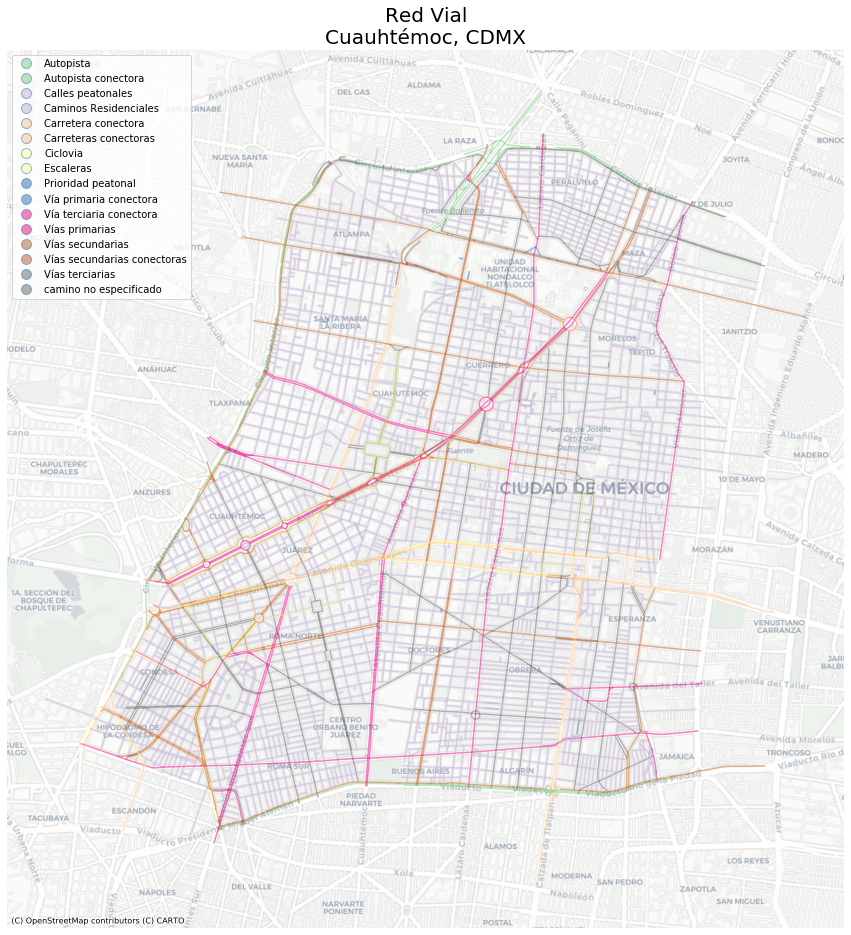

In [193]:
fig, ax = plt.subplots(figsize = (15,19))
#cuau_alc.plot(ax = ax, color = 'lightblue', alpha = 0.3, edgecolor = 'black')
cuauhtemoc1.plot(column = 'fclass', categorical = True, cmap = 'Accent',
          legend = True, legend_kwds = {'loc':'upper left'},
          ax = ax, alpha = 0.5)
ctx.add_basemap(ax,url=ctx.providers.CartoDB.Positron)
plt.axis('off')
plt.title("Red Vial\nCuauhtémoc, CDMX", loc='Center', fontsize=20, fontweight=0, color='black')
fig.savefig('/Users/daniel.rodriguez/Documents/ACC/ACC_PROOF/ACC1/puntos_cuadro5/base_mapas/ROAD_zoom.png', format = 'png', dpi = 200,bbox_inches = "tight")


In [158]:
trf_alc= gpd.read_file('/Users/daniel.rodriguez/Documents/ACC/ACC_PROOF/ACC1//shp_b//processed_data//shp_OSM//traffic.shp')

trf_alc.fclass.value_counts()

traffic_signals        1116
crossing                492
parking                 255
fuel                    211
parking_bicycle         148
turning_circle          130
street_lamp              95
motorway_junction        61
mini_roundabout          49
parking_underground      25
parking_multistorey      15
service                   6
dam                       4
speed_camera              3
slipway                   1
stop                      1
Name: fclass, dtype: int64

In [159]:
list_trf = ['traffic_signals',
            'mini_roundabout',
            'crossing',
            'turning_circle',
            'speed_camera']

trf_alc1 = trf_alc[trf_alc['fclass'].isin(list_trf)]

In [160]:
dict_trf = {'traffic_signals':'Semáforos',
            'mini_roundabout':'Glorieta',
            'crossing':'Cruce peatonal',
            'turning_circle':'Retornos',
            'speed_camera':'Cámaras de velocidad'}

trf_alc1.fclass.replace(dict_trf, inplace = True)

In [162]:
trf_alc_cuau = trf_alc1[trf_alc1['nomgeo']=='Cuauhtemoc']
trf_alc_cuau1 = trf_alc_cuau.to_crs(epsg = 3857)
trf_alc2 = trf_alc1.to_crs(epsg = 3857)

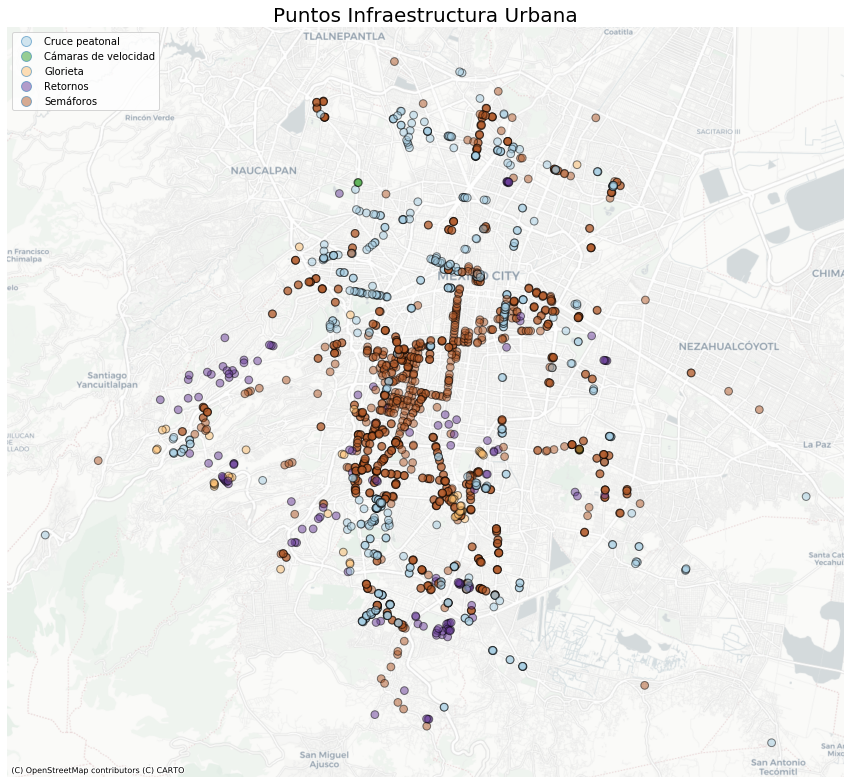

In [194]:
fig, ax = plt.subplots(figsize = (15,19))
#alcaldias.plot(ax = ax, color = 'lightblue', alpha = 0.3, edgecolor = 'black')
trf_alc2.plot(column = 'fclass', categorical = True, cmap = 'Paired',
          legend = True, legend_kwds = {'loc':'upper left'},
          marker = "o", ax = ax, alpha = 0.5, edgecolor = 'black',markersize=60)
ctx.add_basemap(ax,url=ctx.providers.CartoDB.Positron)
plt.axis('off')
plt.title("Puntos Infraestructura Urbana", loc='Center', fontsize=20, fontweight=0, color='black')
fig.savefig('/Users/daniel.rodriguez/Documents/ACC/ACC_PROOF/ACC1/puntos_cuadro5/base_mapas/INF_URB.png', format = 'png', dpi = 200,bbox_inches = "tight")

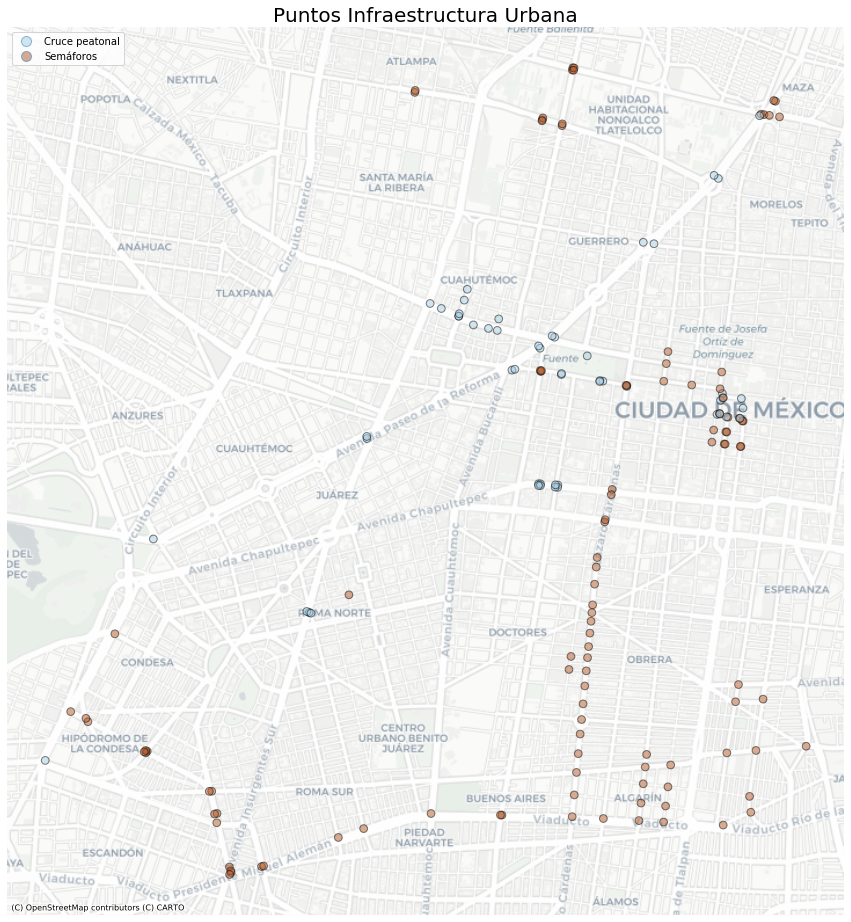

In [195]:
fig, ax = plt.subplots(figsize = (15,19))
#alcaldias.plot(ax = ax, color = 'lightblue', alpha = 0.3, edgecolor = 'black')
trf_alc_cuau1.plot(column = 'fclass', categorical = True, cmap = 'Paired',
          legend = True, legend_kwds = {'loc':'upper left'},
          marker = "o", ax = ax, alpha = 0.5, edgecolor = 'black',markersize=60)
ctx.add_basemap(ax,url=ctx.providers.CartoDB.Positron)
plt.axis('off')
plt.title("Puntos Infraestructura Urbana", loc='Center', fontsize=20, fontweight=0, color='black')
fig.savefig('/Users/daniel.rodriguez/Documents/ACC/ACC_PROOF/ACC1/puntos_cuadro5/base_mapas/INF_URB_zoom.png', format = 'png', dpi = 200,bbox_inches = "tight")

In [166]:
trans_alc = gpd.read_file('/Users//daniel.rodriguez//Documents//ACC//ACC_PROOF//ACC1//shp_b//processed_data//shp_transp//estaciones_transp.shp')

In [169]:
trans_alc.nomgeo.unique()

array(['Venustiano Carranza', 'Benito Juarez', 'Azcapotzalco',
       'Cuauhtemoc', 'Gustavo A. Madero', 'Iztapalapa', 'Miguel Hidalgo',
       'Alvaro Obregon', 'Tlahuac', 'Iztacalco', 'Coyoacan', 'Tlalpan',
       'Xochimilco', 'Cuajimalpa de Morelos', 'Milpa Alta',
       'La Magdalena Contreras'], dtype=object)

In [168]:
trans_alc.fclass.unique()

array(['metro', 'metrobus', 'rtp', 'trolebus', 'cetram'], dtype=object)

In [170]:
trans_alc_cuau = trans_alc[trans_alc['nomgeo']=='Cuauhtemoc']
trans_alc_cuau1 = trans_alc_cuau.to_crs(epsg = 3857)
trans_alc1 = trans_alc.to_crs(epsg = 3857)

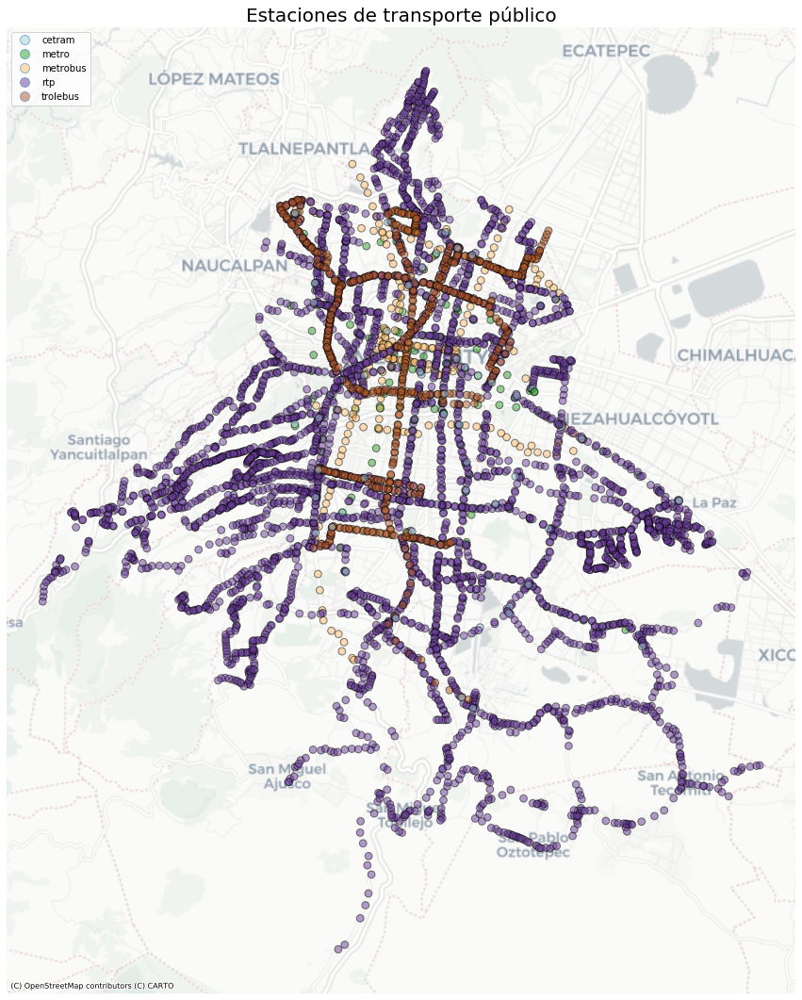

In [196]:
fig, ax = plt.subplots(figsize = (15,19))
#alcaldias.plot(ax = ax, color = 'lightblue', alpha = 0.3, edgecolor = 'black')
trans_alc1.plot(column = 'fclass', categorical = True, cmap = 'Paired',
          legend = True, legend_kwds = {'loc':'upper left'},
          marker = "o", ax = ax, alpha = 0.5, edgecolor = 'black',markersize=60)
ctx.add_basemap(ax,url=ctx.providers.CartoDB.Positron)
plt.axis('off')
plt.title("Estaciones de transporte público", loc='Center', fontsize=20, fontweight=0, color='black')
fig.savefig('/Users/daniel.rodriguez/Documents/ACC/ACC_PROOF/ACC1/puntos_cuadro5/base_mapas/TRANSP.png', format = 'png', dpi = 200,bbox_inches = "tight")

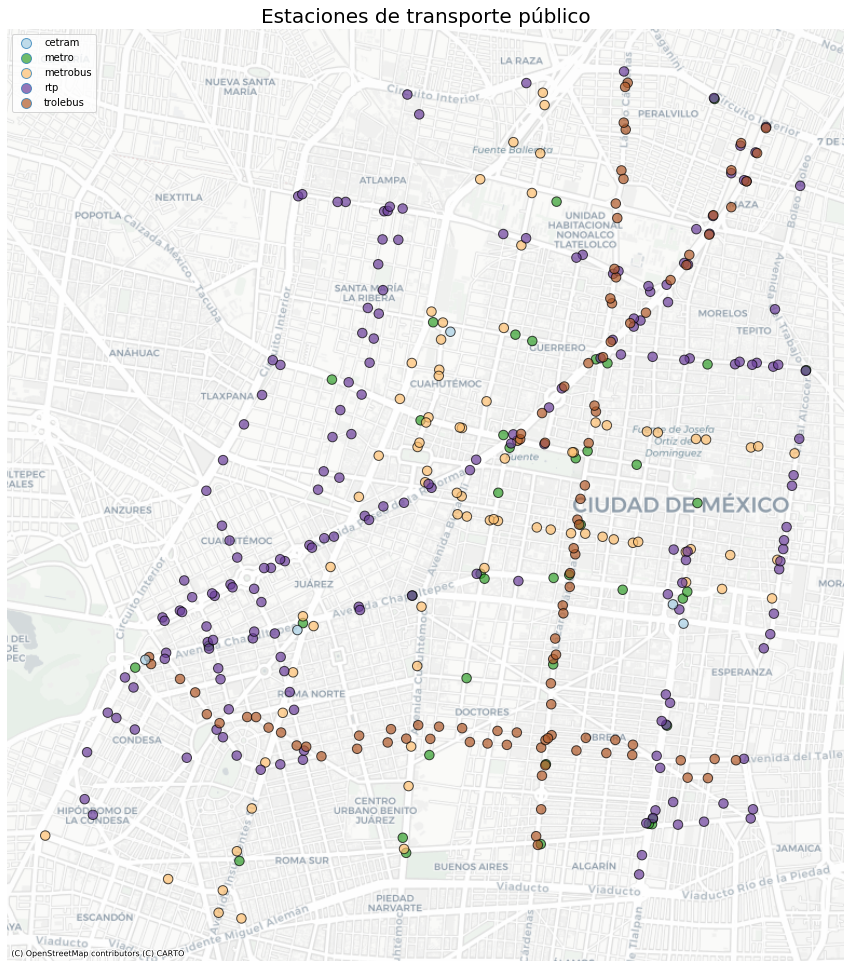

In [197]:
fig, ax = plt.subplots(figsize = (15,19))
#alcaldias.plot(ax = ax, color = 'lightblue', alpha = 0.3, edgecolor = 'black')
trans_alc_cuau1.plot(column = 'fclass', categorical = True, cmap = 'Paired',
          legend = True, legend_kwds = {'loc':'upper left'},
          marker = "o", ax = ax, alpha = 0.7, edgecolor = 'black',markersize=90)
ctx.add_basemap(ax,url=ctx.providers.CartoDB.Positron)
plt.axis('off')
plt.title("Estaciones de transporte público", loc='Center', fontsize=20, fontweight=0, color='black')
fig.savefig('/Users/daniel.rodriguez/Documents/ACC/ACC_PROOF/ACC1/puntos_cuadro5/base_mapas/TRANSP_zoom.png', format = 'png', dpi = 200,bbox_inches = "tight")

In [178]:
intersect = gpd.read_file('/Users/daniel.rodriguez/Documents/ACC/ACC_PROOF/ACC1//shp_b//processed_data//shp_OSM//intersections.shp')
inter = gpd.sjoin(intersect, alcaldias, op = 'intersects')

In [182]:
inter_cuau = inter[inter['nomgeo']=='Cuauhtemoc']
inter_alc_cuau1 = inter_cuau.to_crs(epsg = 3857)
inter_alc1 = inter.to_crs(epsg = 3857)

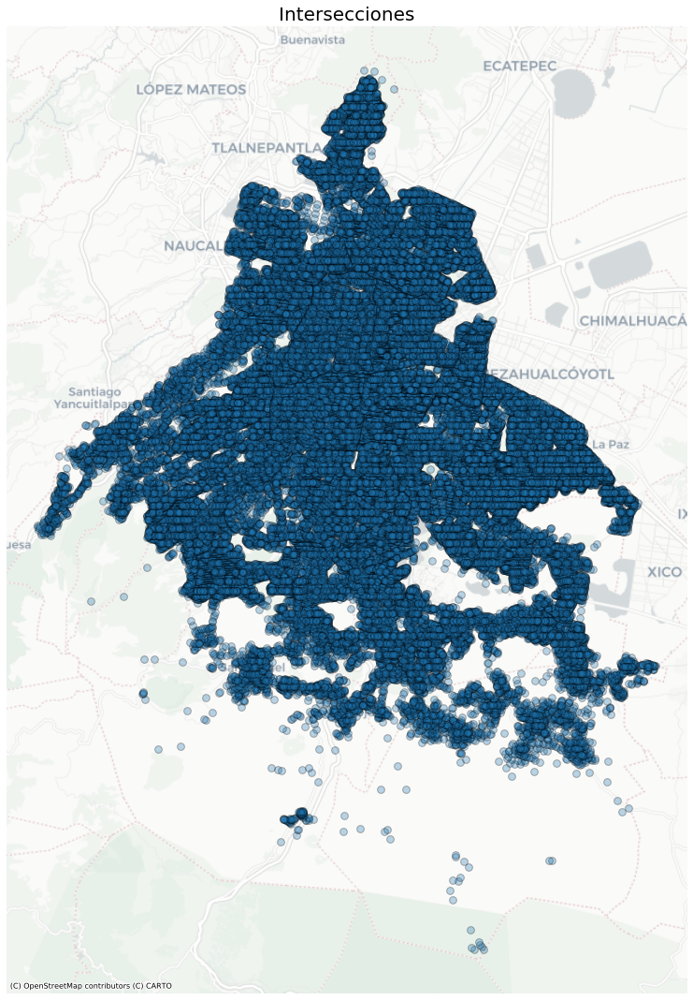

In [198]:
fig, ax = plt.subplots(figsize = (15,19))
#alcaldias.plot(ax = ax, color = 'lightblue', alpha = 0.3, edgecolor = 'black')
inter_alc1.plot(marker = "o", ax = ax, alpha = 0.3, edgecolor = 'black',markersize=60)
ctx.add_basemap(ax,url=ctx.providers.CartoDB.Positron)
plt.axis('off')
plt.title("Intersecciones", loc='Center', fontsize=20, fontweight=0, color='black')
fig.savefig('/Users/daniel.rodriguez/Documents/ACC/ACC_PROOF/ACC1/puntos_cuadro5/base_mapas/INTERSECTIONS.png', format = 'png', dpi = 200,bbox_inches = "tight")

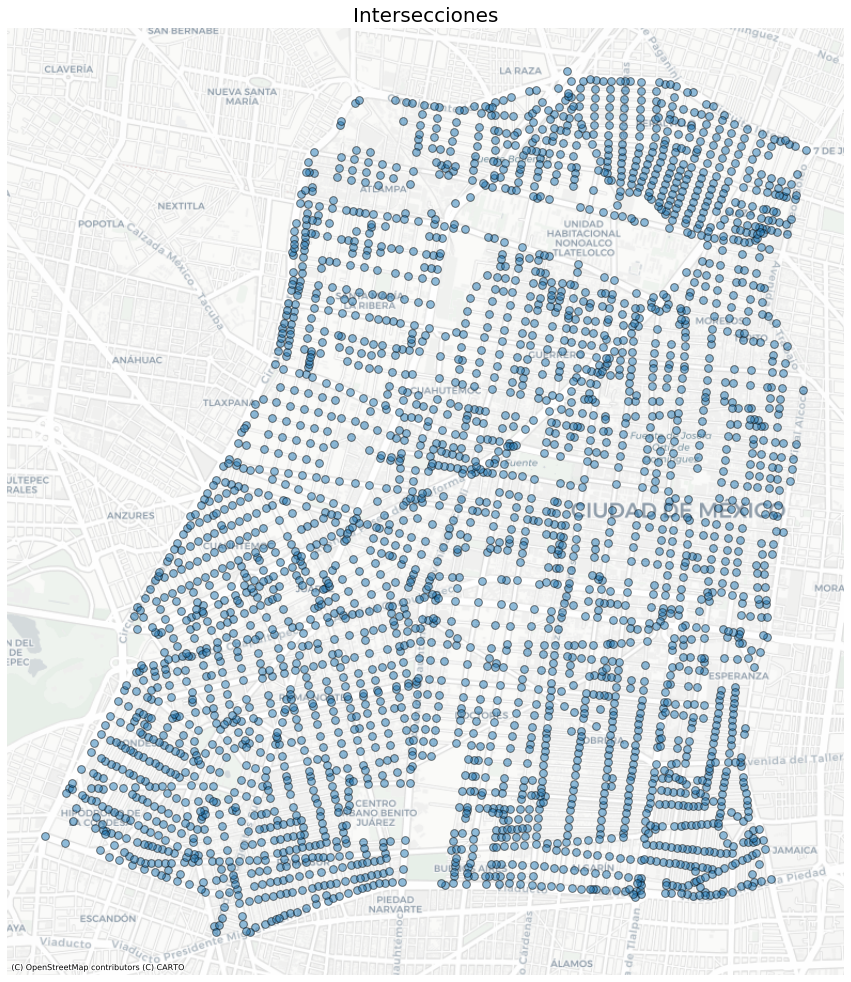

In [199]:
fig, ax = plt.subplots(figsize = (15,19))
#alcaldias.plot(ax = ax, color = 'lightblue', alpha = 0.3, edgecolor = 'black')
inter_alc_cuau1.plot(marker = "o", ax = ax, alpha = 0.5, edgecolor = 'black',markersize=60)
ctx.add_basemap(ax,url=ctx.providers.CartoDB.Positron)
plt.axis('off')
plt.title("Intersecciones", loc='Center', fontsize=20, fontweight=0, color='black')
fig.savefig('/Users/daniel.rodriguez/Documents/ACC/ACC_PROOF/ACC1/puntos_cuadro5/base_mapas/INTERSECTIONS_zoom.png', format = 'png', dpi = 200,bbox_inches = "tight")

In [205]:
cruces_index2 = gpd.read_file('/Users//daniel.rodriguez//Documents//ACC//ACC_PROOF//ACC1//shp_b//processed_data//cruces//cruces_pelis.shp')

In [206]:
cruces_alc = gpd.sjoin(cruces_index2, alcaldias, op = 'intersects')

In [209]:
cruces_cuau = cruces_alc[cruces_alc['nomgeo']=='Cuauhtemoc']
cruces_cuau1 = cruces_cuau.to_crs(epsg = 3857)
cruces1 = cruces_alc.to_crs(epsg = 3857)

In [211]:
cruces1.head()

,calificaci,fclass,geometry,index_right,nomgeo
0,0.478485,cruce_peligroso,POINT (-11036079.93369018 2197795.245380965),4,Benito Juarez
12,0.501815,cruce_peligroso,POINT (-11038305.63006411 2199414.601504751),4,Benito Juarez
19,0.267857,cruce_peligroso,POINT (-11039479.00239429 2198736.281896039),4,Benito Juarez
30,0.200943,cruce_peligroso,POINT (-11038090.15618506 2200622.803279716),4,Benito Juarez
31,0.301188,cruce_peligroso,POINT (-11038064.2509753 2200840.488967096),4,Benito Juarez


In [ ]:
fig, ax = plt.subplots(figsize = (15,19))
#alcaldias.plot(ax = ax, color = 'lightblue', alpha = 0.3, edgecolor = 'black')
cruces1.plot(column = 'calificaci', scheme = 'quantiles',k = 4,cmap = 'Reds_r',
          legend = True,marker = "o", ax = ax, alpha = 0.5, edgecolor = 'black',markersize=60)
ctx.add_basemap(ax,url=ctx.providers.CartoDB.Positron)
ax.get_legend().set_title('Índice de calidad\ndel cruce')
plt.axis('off')
plt.title("Cruces Peligrosos", loc='Center', fontsize=20, fontweight=0, color='black')
fig.savefig('/Users/daniel.rodriguez/Documents/ACC/ACC_PROOF/ACC1/puntos_cuadro5/base_mapas/CRUCES.png', format = 'png', dpi = 200,bbox_inches = "tight")

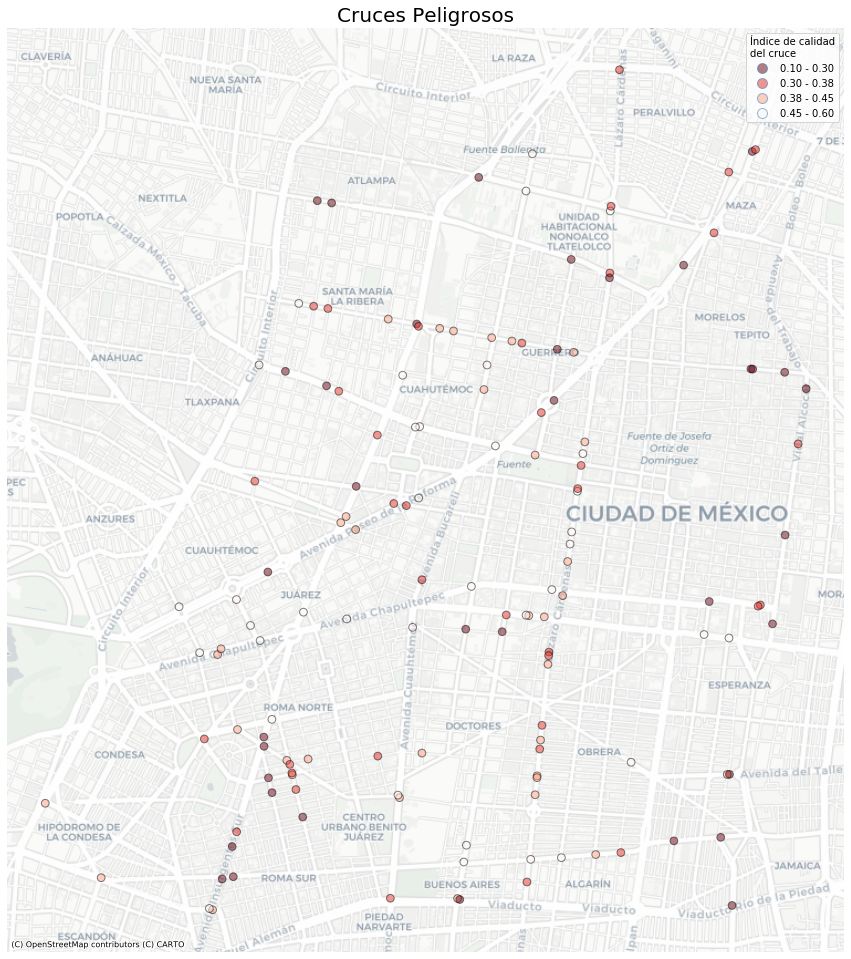

In [221]:
fig, ax = plt.subplots(figsize = (15,19))
#alcaldias.plot(ax = ax, color = 'lightblue', alpha = 0.3, edgecolor = 'black')
cruces_cuau1.plot(column = 'calificaci', scheme = 'quantiles',k = 4,cmap = 'Reds_r',
          legend = True,marker = "o", ax = ax, alpha = 0.5, edgecolor = 'black',markersize=60)
ctx.add_basemap(ax,url=ctx.providers.CartoDB.Positron)
ax.get_legend().set_title('Índice de calidad\ndel cruce')
plt.axis('off')
plt.title("Cruces Peligrosos", loc='Center', fontsize=20, fontweight=0, color='black')
fig.savefig('/Users/daniel.rodriguez/Documents/ACC/ACC_PROOF/ACC1/puntos_cuadro5/base_mapas/CRUCES_zoom.png', format = 'png', dpi = 200,bbox_inches = "tight")

In [15]:
df = pd.DataFrame({'in':['87475','87507','87611'],
'lat':[19.3932103576686,19.4055252446522,19.4100863139054],
'lon':[-99.0678431945927,-99.0812732008545,-99.0781131993811]})


In [16]:
df

,in,lat,lon
0,87475,19.393210,-99.067843
1,87507,19.405525,-99.081273
2,87611,19.410086,-99.078113


In [17]:
gdf = gpd.GeoDataFrame(df, geometry=[Point(xy) for xy in zip(df.lon, df.lat)])
gdf.crs = {'init':'epsg:4326'}
gdf.head()

,in,lat,lon,geometry
0,87475,19.393210,-99.067843,POINT (-99.0678431945927 19.3932103576686)
1,87507,19.405525,-99.081273,POINT (-99.0812732008545 19.4055252446522)
2,87611,19.410086,-99.078113,POINT (-99.07811319938109 19.4100863139054)


In [19]:
gdf_ = gdf.to_crs({'init':'epsg:32613'})

In [21]:
gdf_.head()

,in,lat,lon,geometry
0,87475,19.393210,-99.067843,POINT (1123752.382680737 2155085.285727276)
1,87507,19.405525,-99.081273,POINT (1122289.173649438 2156404.874326407)
2,87611,19.410086,-99.078113,POINT (1122604.873134562 2156923.168790051)


In [22]:
buff = gdf_[gdf_['in']=='87611'].buffer(500)

geo_buff = gpd.GeoDataFrame(geometry = buff)
geo_buff.crs = {'init':'epsg:32613'}


In [23]:
geo_buff.head()

,geometry
2,"POLYGON ((1123104.873134562 2156923.168790051,..."


In [24]:
pts_clean.crs = {'init':'epsg:4326'}

In [25]:
pts_clean.crs

{'init': 'epsg:4326'}

In [26]:
pts_clean_ = pts_clean.to_crs({'init':'epsg:32613'})

In [27]:
lsta_años = ['2017', '2015', '2016', '2014', '2018']
pts1418 = pts_clean_[pts_clean_.ano.isin(lsta_años)]

In [28]:
pts1418.crs

{'init': 'epsg:32613'}

In [29]:
pts1418.head()

,latitud,folio,ano,hora_creac,delegacion,dia_semana,fecha_crea,codigo_cie,mes,hora_cierr,incidente_,tipo_entra,delegaci_1,clas_con_f,fecha_cier,longitud,mesdecierr,geometry
0,19.38676,C5/170621/07339,2017,23:29:01,IZTAPALAPA,Miércoles,21/06/2017,(A) La unidad de atención a emergencias fue de...,6,03:53:51,accidente-choque sin lesionados,LLAMADA DEL 911,IZTAPALAPA,EMERGENCIA,22/06/2017,-99.03350,Junio,POINT (1127398.577000544 2154493.803344689)
1,19.31655,C5/170622/03959,2017,14:14:50,ALVARO OBREGON,Jueves,22/06/2017,(A) La unidad de atención a emergencias fue de...,6,18:05:37,accidente-choque sin lesionados,LLAMADA DEL 911,ALVARO OBREGON,EMERGENCIA,22/06/2017,-99.22090,Junio,POINT (1107901.035044504 2146019.108819003)
2,19.39748,C5/170621/06698,2017,21:36:02,ALVARO OBREGON,Miércoles,21/06/2017,(A) La unidad de atención a emergencias fue de...,6,00:14:49,accidente-choque sin lesionados,LLAMADA DEL 911,ALVARO OBREGON,EMERGENCIA,22/06/2017,-99.19012,Junio,POINT (1110844.233941854 2155119.431264694)
3,19.47901,C5/170621/06943,2017,22:15:26,GUSTAVO A. MADERO,Miércoles,21/06/2017,(A) La unidad de atención a emergencias fue de...,6,01:57:31,accidente-choque con lesionados,LLAMADA DEL 911,GUSTAVO A. MADERO,URGENCIAS MEDICAS,22/06/2017,-99.09755,Junio,POINT (1120292.095673706 2164511.057616035)
4,19.39235,C5/170622/05066,2017,16:34:47,IZTACALCO,Jueves,22/06/2017,(A) La unidad de atención a emergencias fue de...,6,18:37:53,accidente-choque sin lesionados,LLAMADA DEL 911,IZTACALCO,EMERGENCIA,22/06/2017,-99.09867,Junio,POINT (1120505.276178912 2154877.83321845)


In [30]:
pts_muestra = gpd.sjoin(pts1418, geo_buff, op = 'intersects')

In [31]:
pts_muestra.shape

(2814, 19)

In [32]:
pts_muestra.head()

,latitud,folio,ano,hora_creac,delegacion,dia_semana,fecha_crea,codigo_cie,mes,hora_cierr,incidente_,tipo_entra,delegaci_1,clas_con_f,fecha_cier,longitud,mesdecierr,geometry,index_right
171,19.40688,C5/170625/00751,2017,01:36:22,VENUSTIANO CARRANZA,Domingo,25/06/2017,(A) La unidad de atención a emergencias fue de...,6,02:42:22,accidente-choque sin lesionados,LLAMADA DEL 911,IZTACALCO,EMERGENCIA,25/06/2017,-99.08130,Junio,POINT (1122281.175163477 2156555.313845809),2
361,19.40821,C5/170628/03886,2017,15:06:20,IZTACALCO,Miércoles,28/06/2017,(A) La unidad de atención a emergencias fue de...,6,17:35:31,accidente-choque sin lesionados,LLAMADA DEL 911,IZTACALCO,EMERGENCIA,28/06/2017,-99.07678,Junio,POINT (1122752.613117259 2156719.524997709),2
369,19.40674,C5/170628/04253,2017,15:52:23,IZTACALCO,Miércoles,28/06/2017,(A) La unidad de atención a emergencias fue de...,6,18:10:54,accidente-choque sin lesionados,LLAMADA DEL 911,IZTACALCO,EMERGENCIA,28/06/2017,-99.08009,Junio,POINT (1122409.279966001 2156544.148028051),2
486,19.40765,C5/170629/07966,2017,22:15:29,IZTACALCO,Jueves,29/06/2017,(A) La unidad de atención a emergencias fue de...,6,01:33:35,accidente-choque sin lesionados,LLAMADA DEL 911,IZTACALCO,EMERGENCIA,30/06/2017,-99.07577,Junio,POINT (1122861.261870963 2156660.973471469),2
587,19.40898,C5/170701/02657,2017,09:08:31,IZTACALCO,Sábado,01/07/2017,(A) La unidad de atención a emergencias fue de...,7,13:18:02,accidente-choque sin lesionados,LLAMADA DEL 911,VENUSTIANO CARRANZA,EMERGENCIA,01/07/2017,-99.07650,Julio,POINT (1122779.1925377 2156806.098272167),2


In [33]:
pts_muestra.incidente_.value_counts()

accidente-choque sin lesionados               1838
accidente-choque con lesionados                542
lesionado-atropellado                          317
accidente-motociclista                          42
accidente-volcadura                             32
cadáver-atropellado                             18
lesionado-accidente automovilístico              9
accidente-otros                                  7
cadáver-accidente automovilístico                3
accidente-persona atrapada / desbarrancada       3
accidente-choque con prensados                   1
detención ciudadana-atropellado                  1
sismo-choque sin lesionados                      1
Name: incidente_, dtype: int64

In [34]:
acc_c_les = pts_muestra[pts_muestra['incidente_']=='accidente-choque con lesionados']

In [35]:
acc_c_les.head()

,latitud,folio,ano,hora_creac,delegacion,dia_semana,fecha_crea,codigo_cie,mes,hora_cierr,incidente_,tipo_entra,delegaci_1,clas_con_f,fecha_cier,longitud,mesdecierr,geometry,index_right
4439,19.40786,C5/170908/07122,2017,17:20:42,IZTACALCO,Viernes,08/09/2017,(A) La unidad de atención a emergencias fue de...,9,18:09:49,accidente-choque con lesionados,LLAMADA DEL 911,IZTACALCO,URGENCIAS MEDICAS,08/09/2017,-99.07456,Septiembre,POINT (1122988.026201114 2156688.704297137),2
6065,19.40898,C5/170916/06403,2017,13:15:23,IZTACALCO,Sábado,16/09/2017,(A) La unidad de atención a emergencias fue de...,9,18:10:58,accidente-choque con lesionados,LLAMADA DEL 911,VENUSTIANO CARRANZA,URGENCIAS MEDICAS,16/09/2017,-99.07650,Septiembre,POINT (1122779.1925377 2156806.098272167),2
6093,19.40595,C5/170917/00599,2017,01:13:01,IZTACALCO,Domingo,17/09/2017,(A) La unidad de atención a emergencias fue de...,9,06:08:06,accidente-choque con lesionados,LLAMADA DEL 911,IZTACALCO,URGENCIAS MEDICAS,17/09/2017,-99.07892,Septiembre,POINT (1122535.660743256 2156460.623775791),2
6109,19.40739,C5/170917/04045,2017,12:54:33,VENUSTIANO CARRANZA,Domingo,17/09/2017,(A) La unidad de atención a emergencias fue de...,9,14:48:08,accidente-choque con lesionados,LLAMADA DEL 911,VENUSTIANO CARRANZA,URGENCIAS MEDICAS,17/09/2017,-99.08123,Septiembre,POINT (1122286.586170156 2156612.240539057),2
6390,19.40862,GA/170923/10229,2017,20:23:12,IZTACALCO,Sábado,23/09/2017,(A) La unidad de atención a emergencias fue de...,9,22:03:55,accidente-choque con lesionados,RADIO,IZTACALCO,URGENCIAS MEDICAS,23/09/2017,-99.07475,Septiembre,POINT (1122965.073137233 2156772.45840115),2


In [36]:
acc_c_les1 = acc_c_les[['geometry']].buffer(200)

In [37]:
acc_c_les.crs

{'init': 'epsg:32613'}

In [38]:
hex_alc.crs

{'init': 'epsg:4326'}

In [39]:
hex_alc_1 = hex_alc.to_crs({'init':'epsg:32613'})

In [40]:
hex_alc_1.loc[87611:87611,:]

,left,bottom,right,top,geometry,index_right,nomgeo
87611,-99.07864,19.40963,-99.077587,19.410542,"POLYGON ((1122549.346455491 2156921.254706555,...",8,Venustiano Carranza


In [41]:
acc_c_les2 = acc_c_les1.to_crs({'init':'epsg:3857'})
hex_alc_2 = hex_alc_1.to_crs({'init':'epsg:3857'})
acc_c_les3 = acc_c_les.to_crs({'init':'epsg:3857'})

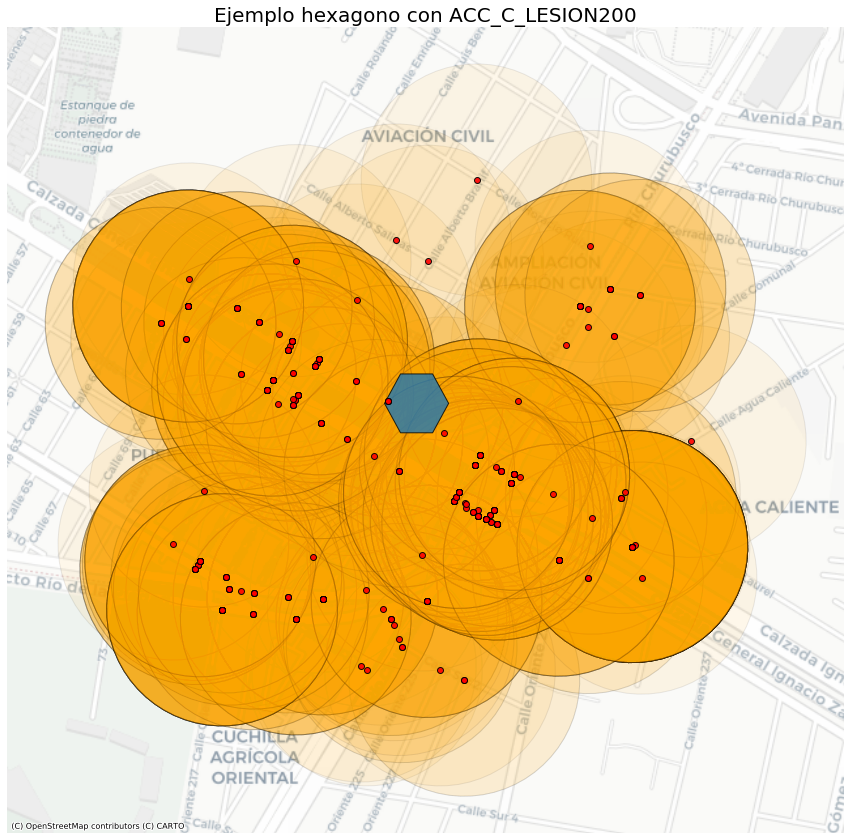

In [42]:
fig, ax = plt.subplots(figsize = (15,19))
acc_c_les2.plot(ax = ax, color = 'orange', alpha = 0.08, edgecolor = 'black')
hex_alc_2.loc[87611:87611,:].plot(ax = ax, alpha = 0.8, edgecolor = 'black')
acc_c_les3.plot(ax = ax, alpha = 0.9, color = 'red',edgecolor = 'black')
#hex_alc1.loc[87612:87612,:].plot(ax = ax, alpha = 0.5, edgecolor = 'black',markersize=60)
ctx.add_basemap(ax,url=ctx.providers.CartoDB.Positron)
#ax.get_legend().set_title('Índice de calidad\ndel cruce')
plt.axis('off')
plt.title("Ejemplo hexagono con ACC_C_LESION200", loc='Center', fontsize=20, fontweight=0, color='black')
fig.savefig('/Users/daniel.rodriguez/Documents/ACC_ult/images_res/ejem_acc_c_les200.png', format = 'png', dpi = 200,bbox_inches = "tight")